Matt Thomas (met8k@virginia.edu)
DS5001
4/30/20

### Import TF-IDF Table and PreProcess

In [26]:
import pandas as pd
from sklearn.decomposition import PCA
from scipy.linalg import norm
import plotly_express as px

In [27]:
TFIDF = pd.read_csv('../FinalProject/TFIDF.csv', index_col = ['doc_source', 'doc_id'])

In [28]:
VOCAB = pd.read_csv('../FinalProject/VOCAB2.csv', index_col='term_id')
LIB = pd.read_csv('../FinalProject/LIBRARY.csv', index_col='doc_source')

In [29]:
LIB.head()

,doc_id,doc_title,doc_content,doc_date,doc_url
doc_source,,,,,
PowerLine,48,These Zins Are a Dusi,I’ve been falling behind on many regular feat...,11/03/2013,http://feeds.powerlineblog.com/~r/powerlineblo...
PowerLine,49,NY Times Editorial Board Hacked by The Onion,"At least I think it was the Onion. Someone, a...",11/03/2013,http://feeds.powerlineblog.com/~r/powerlineblo...
PowerLine,50,The line Obama crossed,Obamacare was enacted on a foundational set o...,11/03/2013,http://feeds.powerlineblog.com/~r/powerlineblo...
PowerLine,51,Sham/Wow,It’s unfair to compare and contrast Barack Ob...,11/03/2013,http://feeds.powerlineblog.com/~r/powerlineblo...
PowerLine,52,A Quarterback Controversy With a Political Twist?,Public Policy Polling ran a survey here in Mi...,11/03/2013,http://feeds.powerlineblog.com/~r/powerlineblo...


In [30]:
#normalize vector length
TFIDF = TFIDF.apply(lambda x: x / norm(x), 1)

In [31]:
TFIDF.head()

4695      4700  4716  4719      4726      4728  4733  4734  \
doc_source doc_id                                                               
Daily Kos  96       0.0  0.000000   0.0   0.0  0.000000  0.000000   0.0   0.0   
           97       0.0  0.081079   0.0   0.0  0.000000  0.000000   0.0   0.0   
           98       0.0  0.000000   0.0   0.0  0.050855  0.047878   0.0   0.0   
           99       0.0  0.000000   0.0   0.0  0.000000  0.000000   0.0   0.0   
           100      0.0  0.000000   0.0   0.0  0.000000  0.000000   0.0   0.0   

                   4755  4767  ...  172416  172418  172421  172487  172496  \
doc_source doc_id              ...                                           
Daily Kos  96       0.0   0.0  ...     0.0     0.0     0.0     0.0     0.0   
           97       0.0   0.0  ...     0.0     0.0     0.0     0.0     0.0   
           98       0.0   0.0  ...     0.0     0.0     0.0     0.0     0.0   
           99       0.0   0.0  ...     0.0     0.0     0.0     0.0     0.0   
           100      0.0   0.0  ...     0.0     0.0     0.0     0.0     0.0   

                   172501  172507  172567  172568  172640  
doc_source doc_id                                          
Daily Kos  96         0.0     0.0     0.0     0.0     0.0  
           97         0.0     0.0     0.0     0.0     0.0  
           98         0.0     0.0     0.0     0.0     0.0  
           99         0.0     0.0     0.0     0.0     0.0  
           100        0.0     0.0     0.0     0.0     0.0  

[5 rows x 18995 columns]

### Perform PCA Using 10 Components and Index By Article Title

In [32]:
pca = PCA(n_components=10)

In [33]:
DCM = pd.DataFrame(pca.fit_transform(TFIDF), index=TFIDF.index)
DCM.columns = [f'PC{i}' for i in DCM.columns]

In [34]:
docs_zip = dict(zip(LIB.doc_id, LIB.doc_title))

In [35]:
DCM= DCM.reset_index()
DCM['doc_title'] = DCM.doc_id.map(docs_zip)

In [36]:
DCM = DCM.set_index(['doc_source', 'doc_id', 'doc_title'])
DCM.sample(5)

PC0  \
doc_source doc_id doc_title                                                      
PowerLine  50946  An instant thaw of U.S.-Israeli relations          -0.015617   
Daily Kos  242687 Conservative columnist: Arpaio pardon reminds u...  0.003909   
PowerLine  838467 Has Trump tapped Rand Paul for a mission to the... -0.015228   
Daily Kos  160898 Budget committee approves Scott Walker's plan t... -0.001177   
           150432 Morning Digest: Rob Quist leads Greg Gianforte ...  0.195305   

                                                                           PC1  \
doc_source doc_id doc_title                                                      
PowerLine  50946  An instant thaw of U.S.-Israeli relations           0.053634   
Daily Kos  242687 Conservative columnist: Arpaio pardon reminds u...  0.007413   
PowerLine  838467 Has Trump tapped Rand Paul for a mission to the...  0.051457   
Daily Kos  160898 Budget committee approves Scott Walker's plan t... -0.047895   
           150432 Morning Digest: Rob Quist leads Greg Gianforte ... -0.090975   

                                                                           PC2  \
doc_source doc_id doc_title                                                      
PowerLine  50946  An instant thaw of U.S.-Israeli relations          -0.032335   
Daily Kos  242687 Conservative columnist: Arpaio pardon reminds u... -0.010122   
PowerLine  838467 Has Trump tapped Rand Paul for a mission to the... -0.019421   
Daily Kos  160898 Budget committee approves Scott Walker's plan t...  0.002169   
           150432 Morning Digest: Rob Quist leads Greg Gianforte ...  0.165040   

                                                                           PC3  \
doc_source doc_id doc_title                                                      
PowerLine  50946  An instant thaw of U.S.-Israeli relations          -0.028858   
Daily Kos  242687 Conservative columnist: Arpaio pardon reminds u...  0.000308   
PowerLine  838467 Has Trump tapped Rand Paul for a mission to the... -0.031140   
Daily Kos  160898 Budget committee approves Scott Walker's plan t... -0.077896   
           150432 Morning Digest: Rob Quist leads Greg Gianforte ...  0.168814   

                                                                           PC4  \
doc_source doc_id doc_title                                                      
PowerLine  50946  An instant thaw of U.S.-Israeli relations           0.036014   
Daily Kos  242687 Conservative columnist: Arpaio pardon reminds u... -0.073799   
PowerLine  838467 Has Trump tapped Rand Paul for a mission to the...  0.035255   
Daily Kos  160898 Budget committee approves Scott Walker's plan t... -0.030881   
           150432 Morning Digest: Rob Quist leads Greg Gianforte ... -0.072000   

                                                                           PC5  \
doc_source doc_id doc_title                                                      
PowerLine  50946  An instant thaw of U.S.-Israeli relations          -0.067654   
Daily Kos  242687 Conservative columnist: Arpaio pardon reminds u...  0.026736   
PowerLine  838467 Has Trump tapped Rand Paul for a mission to the... -0.088207   
Daily Kos  160898 Budget committee approves Scott Walker's plan t...  0.056634   
           150432 Morning Digest: Rob Quist leads Greg Gianforte ...  0.070013   

                                                                           PC6  \
doc_source doc_id doc_title                                                      
PowerLine  50946  An instant thaw of U.S.-Israeli relations          -0.075252   
Daily Kos  242687 Conservative columnist: Arpaio pardon reminds u...  0.056562   
PowerLine  838467 Has Trump tapped Rand Paul for a mission to the... -0.061667   
Daily Kos  160898 Budget committee approves Scott Walker's plan t...  0.011524   
           150432 Morning Digest: Rob Quist leads Greg Gianforte ... -0.066571   

                                                  

### Get Loadings and Examine

In [37]:
LOADINGS = pd.DataFrame(pca.components_.T, index=TFIDF.T.index, columns=DCM.columns)

In [38]:
LOADINGS

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9
4695,0.005130,0.003451,0.000763,0.003688,0.001009,-0.001125,-0.002696,-0.003364,0.001887,0.006299
4700,0.000639,-0.006040,0.003051,-0.004457,0.002964,-0.000200,0.002430,-0.003680,-0.001613,0.001593
4716,0.000373,0.000718,0.000580,0.000799,-0.001454,0.000398,0.002296,0.001189,-0.001873,0.002672
4719,0.001774,0.001640,-0.001281,0.000301,0.001106,-0.001128,0.002488,-0.001401,0.001639,-0.000267
4726,0.009293,-0.001854,-0.001390,-0.004588,0.002874,-0.009211,-0.003285,0.007756,-0.001941,0.000986
...,...,...,...,...,...,...,...,...,...,...
172501,0.005436,0.000590,-0.005447,-0.003907,-0.000787,0.002426,-0.003327,0.003074,0.003535,0.001269
172507,0.002744,-0.000598,-0.002027,-0.001920,-0.000906,0.002357,0.000072,-0.000972,-0.001310,0.001453
172567,0.000232,0.000986,-0.000208,0.000613,0.001422,-0.001146,0.000777,-0.001826,0.000641,-0.000820
172568,0.001187,0.000388,-0.002155,0.000596,0.002696,0.002026,0.000494,0.000762,-0.002650,0.000827


In [39]:
LOADINGS['term_str'] = LOADINGS.apply(lambda x: VOCAB.loc[int(x.name)].term_str, 1)

In [40]:
LOADINGS.head()

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,term_str
4695,0.005130,0.003451,0.000763,0.003688,0.001009,-0.001125,-0.002696,-0.003364,0.001887,0.006299,aaron
4700,0.000639,-0.006040,0.003051,-0.004457,0.002964,-0.000200,0.002430,-0.003680,-0.001613,0.001593,aarp
4716,0.000373,0.000718,0.000580,0.000799,-0.001454,0.000398,0.002296,0.001189,-0.001873,0.002672,aba
4719,0.001774,0.001640,-0.001281,0.000301,0.001106,-0.001128,0.002488,-0.001401,0.001639,-0.000267,aback
4726,0.009293,-0.001854,-0.001390,-0.004588,0.002874,-0.009211,-0.003285,0.007756,-0.001941,0.000986,abandon


In [41]:
lb0_pos = LOADINGS.sort_values('PC0', ascending=True).head(10).term_str.str.cat(sep=' ')
lb0_neg = LOADINGS.sort_values('PC0', ascending=False).head(10).term_str.str.cat(sep=' ')
lb1_pos = LOADINGS.sort_values('PC1', ascending=True).head(10).term_str.str.cat(sep=' ')
lb1_neg = LOADINGS.sort_values('PC1', ascending=False).head(10).term_str.str.cat(sep=' ')

In [42]:
print('Articles PC0+', lb0_pos)
print('Articles PC0-', lb0_neg)
print('Articles PC1+', lb1_pos)
print('Articles PC1-', lb1_neg)

Articles PC0+ https yesterday video pic posted fbi comey investigation readers audio
Articles PC0- newsletters unsubscribe recaptcha inbox alerts privacy signing google protected receive
Articles PC1+ obamacare insurance health trumpcare repeal medicaid care affordable vote republicans
Articles PC1- fbi investigation russian intelligence russia comey counsel mueller information collusion


The loadings aren't very informative but we can see for both PCs that there is an emphasis on the Russia investigation. Interpreting meaning from these PCs is difficult.

### Visualize

In [43]:
def vis_pcs(M, a, b, prefix='PC'):
    fig = px.scatter(M, prefix + str(a), prefix + str(b), 
                        color='doc_source', 
                        hover_name='doc_title', marginal_x='box')
    fig.show()

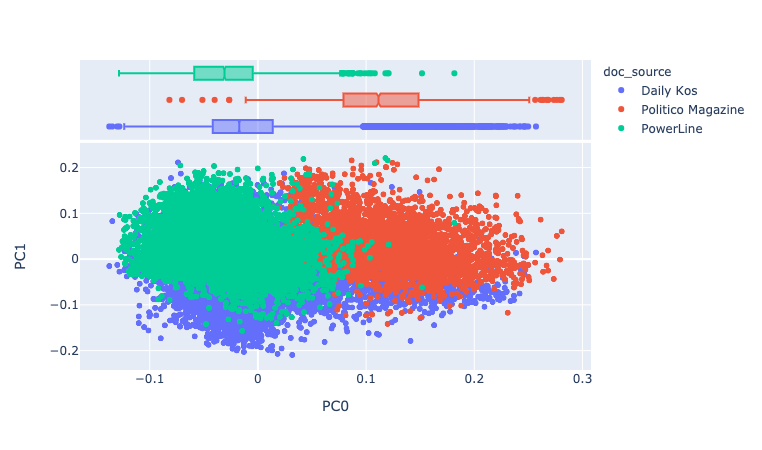

In [45]:
DCM = DCM.reset_index()
vis_pcs(DCM, 0, 1)

Interesting, there's a clear separation between Politico and Powerline although Daily Kos (explicitly progressive) aligns more with Powerline and is more widely distributed.

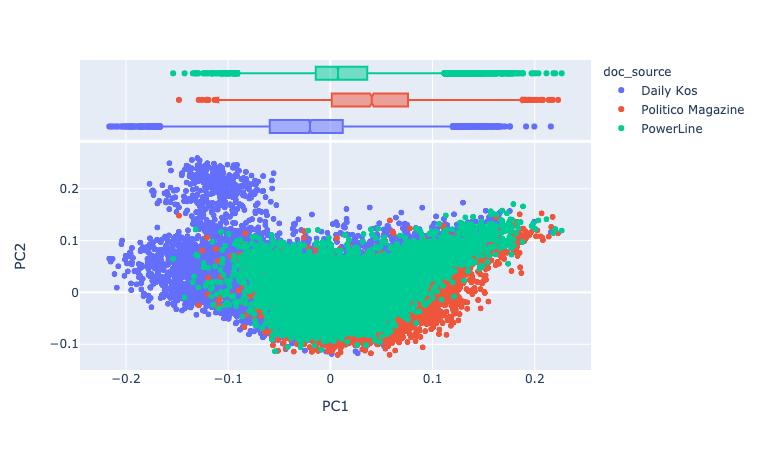

In [39]:
vis_pcs(DCM, 1, 2)

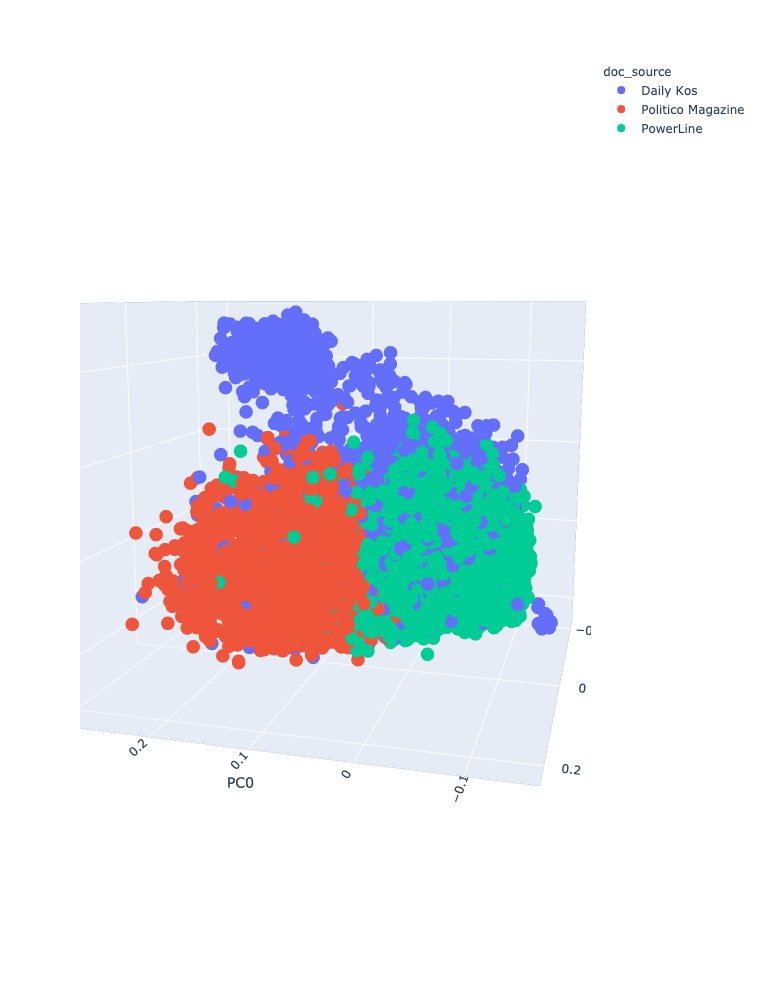

In [40]:
px.scatter_3d(DCM, 'PC0', 'PC1','PC2', color='doc_source', hover_name='doc_title', height=1000, width=1200)

#### Save Work

In [47]:
DCM = DCM.set_index(['doc_source', 'doc_id'])

In [48]:
DCM.to_csv('PCA.csv')

In [52]:
VOCAB = VOCAB.reset_index()
terms = dict(zip(VOCAB.term_str, VOCAB.term_id))

In [53]:
LOADINGS['term_id'] = LOADINGS.term_str.map(terms)

In [55]:
LOADINGS = LOADINGS.set_index('term_id') #Set index so it matches VOCAB table

In [56]:
LOADINGS

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,term_str
term_id,,,,,,,,,,,
4695,0.005130,0.003451,0.000763,0.003688,0.001009,-0.001125,-0.002696,-0.003364,0.001887,0.006299,aaron
4700,0.000639,-0.006040,0.003051,-0.004457,0.002964,-0.000200,0.002430,-0.003680,-0.001613,0.001593,aarp
4716,0.000373,0.000718,0.000580,0.000799,-0.001454,0.000398,0.002296,0.001189,-0.001873,0.002672,aba
4719,0.001774,0.001640,-0.001281,0.000301,0.001106,-0.001128,0.002488,-0.001401,0.001639,-0.000267,aback
4726,0.009293,-0.001854,-0.001390,-0.004588,0.002874,-0.009211,-0.003285,0.007756,-0.001941,0.000986,abandon
...,...,...,...,...,...,...,...,...,...,...,...
172501,0.005436,0.000590,-0.005447,-0.003907,-0.000787,0.002426,-0.003327,0.003074,0.003535,0.001269,zones
172507,0.002744,-0.000598,-0.002027,-0.001920,-0.000906,0.002357,0.000072,-0.000972,-0.001310,0.001453,zoning
172567,0.000232,0.000986,-0.000208,0.000613,0.001422,-0.001146,0.000777,-0.001826,0.000641,-0.000820,zucker


In [57]:
LOADINGS.to_csv('PCA_LOADINGS.csv')